# Milestone 1: Read into AnnData object

*1.1. Read the pancreas dataset*

*1.2. Why do we use an AnnData object?*

*1.3. Where are the un/spliced counts and annotations for observations and variables stored?*

*1.4. Describe in form of text the rational for these steps in your markdown report.*

Load necessary packages, scanpy and scVelo.

In [1]:
import scanpy as sc
import scvelo as scv
import numpy as np
import matplotlib.pyplot as plt

Read in the pancreas dataset which is availible within the scvelo package.

In [2]:
adata = scv.datasets.pancreas()

The dataset is now stored in an AnnData object. AnnData is a popular format for storing single cell data used by scanpy and scVelo. It allows for a comprenhensive and scalable storage of data matrix and annotation information features and samples on different layers.

<img src="https://falexwolf.de/img/scanpy/anndata.svg" alt="Anndata object" style="width: 400px;"/>

Spliced counts

In [3]:
adata.layers['spliced']

<3696x27998 sparse matrix of type '<class 'numpy.float32'>'
	with 9298890 stored elements in Compressed Sparse Row format>

Unspliced counts

In [4]:
adata.layers['unspliced']

<3696x27998 sparse matrix of type '<class 'numpy.float32'>'
	with 3156504 stored elements in Compressed Sparse Row format>

Cell annotation

In [5]:
adata.obs

,clusters_coarse,clusters,S_score,G2M_score
index,,,,
AAACCTGAGAGGGATA,Pre-endocrine,Pre-endocrine,-0.224902,-0.252071
AAACCTGAGCCTTGAT,Ductal,Ductal,-0.014707,-0.232610
AAACCTGAGGCAATTA,Endocrine,Alpha,-0.171255,-0.286834
AAACCTGCATCATCCC,Ductal,Ductal,0.599244,0.191243
AAACCTGGTAAGTGGC,Ngn3 high EP,Ngn3 high EP,-0.179981,-0.126030
...,...,...,...,...
TTTGTCAAGTGACATA,Pre-endocrine,Pre-endocrine,-0.235896,-0.266101
TTTGTCAAGTGTGGCA,Ngn3 high EP,Ngn3 high EP,0.279374,-0.204047
TTTGTCAGTTGTTTGG,Ductal,Ductal,-0.045692,-0.208907


Gene annotation

In [6]:
adata.var

,highly_variable_genes
index,
Xkr4,False
Gm37381,NaN
Rp1,NaN
Rp1-1,NaN
Sox17,NaN
...,...
Gm28672,NaN
Gm28670,NaN
Gm29504,NaN


# Milestone 2: Preprocessing 

*2.1. Why do we need to filter out a number of genes?*

*2.2. What are meaningful gene selection criteria and why?*

*2.3. What is the rationale of normalizing the counts?*

*2.4. After gene selection and normalization the data is log-transformed. What is it necessary for?*

*2.5. Show how the PCA embeddings compare when you use log vs. non-log data.*


In the preprocessing step we need to filter cells, genes and normalise. 

Some genes don't provide any meaningful biological information. We filter them out to remove noise. Additionally, it cuts down computational time downstream. 

Selection criteria for gene filtering (Luecken et al., 2019): 
- Remove genes expressed in only few cells (not informative of the cellular heterogeneity)
- Check Malat1 expression as it is frequently detected in poly-A captured RNA-seq data independent of protocol. Also, the lysed cells often have higher expression of Malat1
- Mitochondrial and ribosmal reads in poor quality cells
- Eliminate droputs

Next we need to normalise the counts because of differences in library depth between cells and sampling effects. Count depths can differ between identical cells due to inherent variance in the multiple steps of sequence capture, reverse transcription, and the sequencing proper. This serves to allow for cells to be intra-comparable. Genes can also be scaled, for example with log transformation. 

Log transform is a canonical way to measure expression change. It mitigates mean-variance relationship and reduces data skewness (Brennecke et al., 2013). 

In [7]:
adata_log = scv.pp.filter_and_normalize(adata, copy=True)

Normalized count data: X, spliced, unspliced.
Logarithmized X.


In [8]:
adata_nolog = scv.pp.filter_and_normalize(adata, copy=True, log=False)

Normalized count data: X, spliced, unspliced.


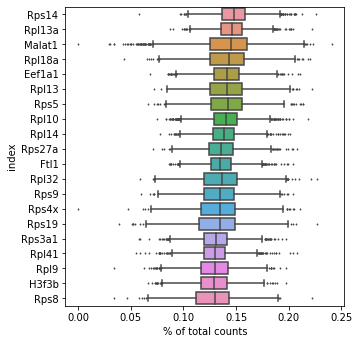

In [9]:
sc.pl.highest_expr_genes(adata_log, n_top=20)

We also remove the Malat1 gene.

In [10]:
malat_list = ['Malat1']
malat_indicator = np.in1d(adata_log.var_names, malat_list)
adata_log = adata_log[:, ~malat_indicator]

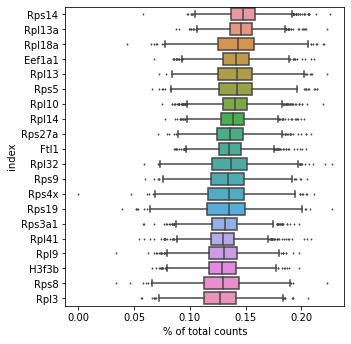

In [11]:
sc.pl.highest_expr_genes(adata_log, n_top=20)

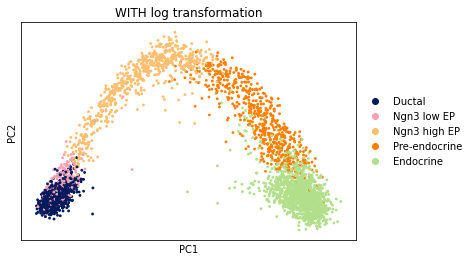

In [12]:
sc.tl.pca(adata_log, svd_solver='arpack')
sc.pl.pca(adata_log, color='clusters_coarse', title='WITH log transformation')

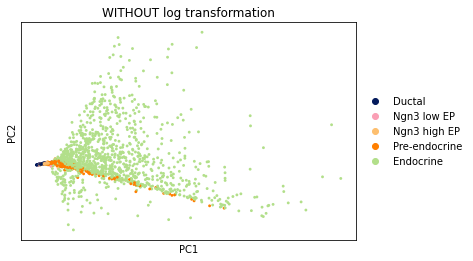

In [13]:
sc.tl.pca(adata_nolog, svd_solver='arpack')
sc.pl.pca(adata_nolog, color='clusters_coarse', title='WITHOUT log transformation')

Log transformed data looks better, we can already see cells clustering together within predefined clusters. Without log transformation data is heavily skewed. 

# Milestone 3: Neighbor graph, and moments

*3.1. The PCA representation (computed on the log-normalized data) is used to compute a neighbor graph from cell-to-cell distances. What does this graph represent and what can it be used for?*

*3.2. Now, we use the graph to compute first-order moments, i.e., for each cell, the mean (first-order moments) and variance (second-order moments) of its neighboring cells is computed. This can also be regarded as a knn-imputation of the counts.*

*3.3. Show how the k parameter (number of neighbors) impacts the imputed counts, e.g., by comparing the imputed gene expression of two genes with different values for k.*

We keep the log transformed data and set the `.raw` attribute of the AnnData object to the normalized and logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. 

In [14]:
adata = adata_log
adata.raw = adata

Now use the PCA representation of data matrix to compute neighborhood graph of cells. It is a knn graph, it represents distance and connectivity between cells. Each of the cells is connected to its K nearest neigboring cells. The default k in scVelo is 30.

 Next we calcualte moments: for each cell, the  mean (first-order moments) and variance (second-order moments) of its neighboring cells is computed. This can also be regarded as a knn-imputation of the counts.

The imputed counts vary depending on the number of neighbors (k). We inspect the relationship between imputed mean and variance (Ms and Mu) for different values of the k parameter.

In [30]:
adata_nn_10 = adata.copy()
adata_nn_30 = adata.copy()
adata_nn_100 = adata.copy()
adata_nn_300 = adata.copy()

scv.pp.neighbors(adata_nn_10, n_neighbors=10)
scv.pp.moments(adata_nn_10, n_neighbors=10)

scv.pp.neighbors(adata_nn_30, n_neighbors=30)
scv.pp.moments(adata_nn_30, n_neighbors=30)

scv.pp.neighbors(adata_nn_100, n_neighbors=100)
scv.pp.moments(adata_nn_100, n_neighbors=100)

scv.pp.neighbors(adata_nn_300, n_neighbors=300)
scv.pp.moments(adata_nn_300, n_neighbors=300)

computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing neighbors
    finished (0:00:02) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:12) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing neighbors
    finished (0:00:06) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectiviti

In [27]:
scv.settings.set_figure_params(dpi=100)

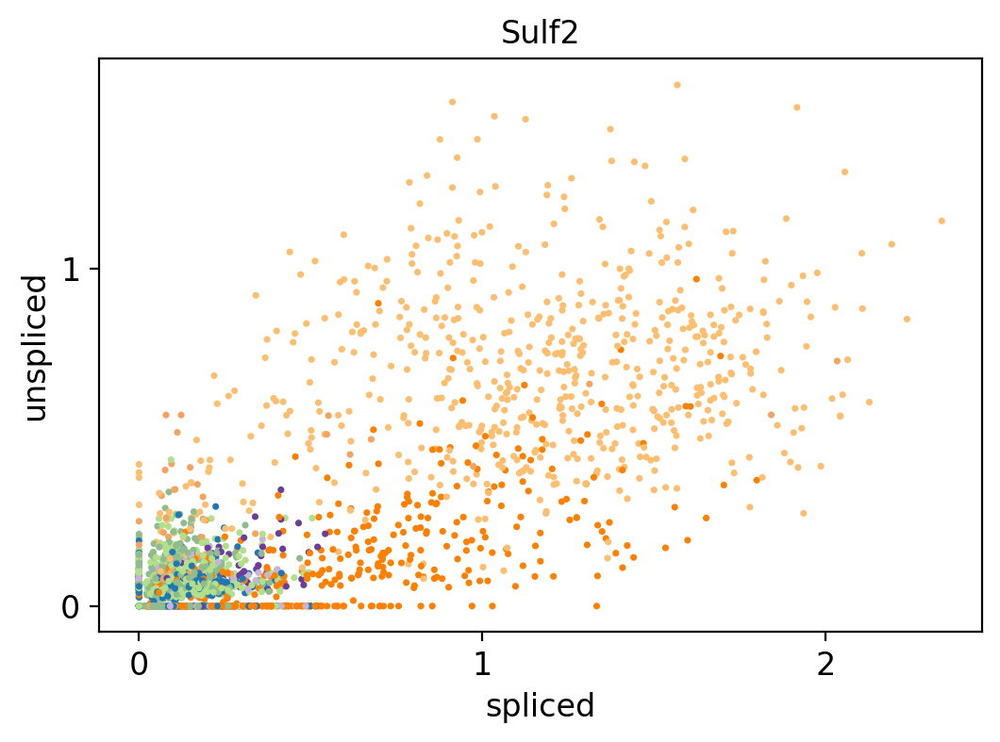

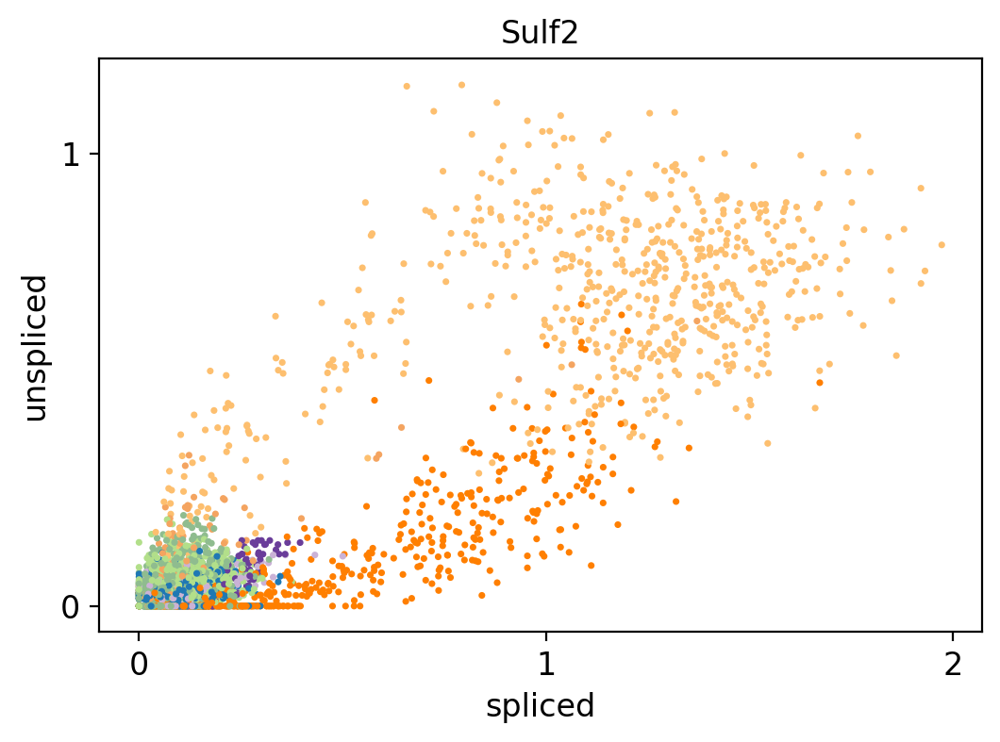

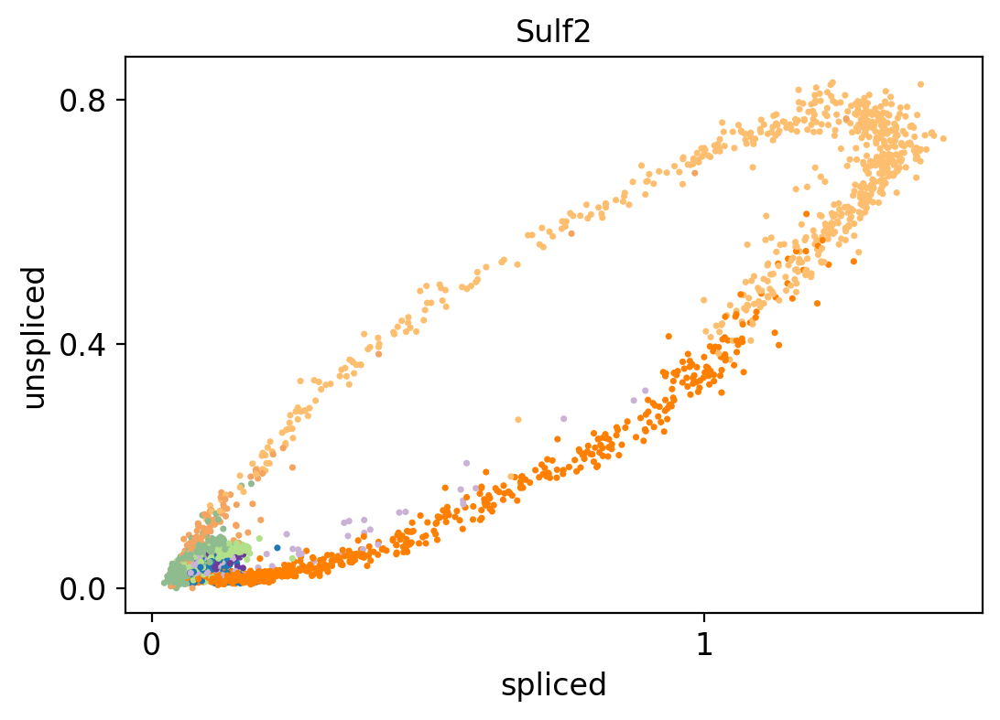

In [31]:
scv.pl.scatter(adata_nn_10, ['Sulf2'], color='clusters')
scv.pl.scatter(adata_nn_30, ['Sulf2'], color='clusters')
scv.pl.scatter(adata_nn_300, ['Sulf2'], color='clusters')

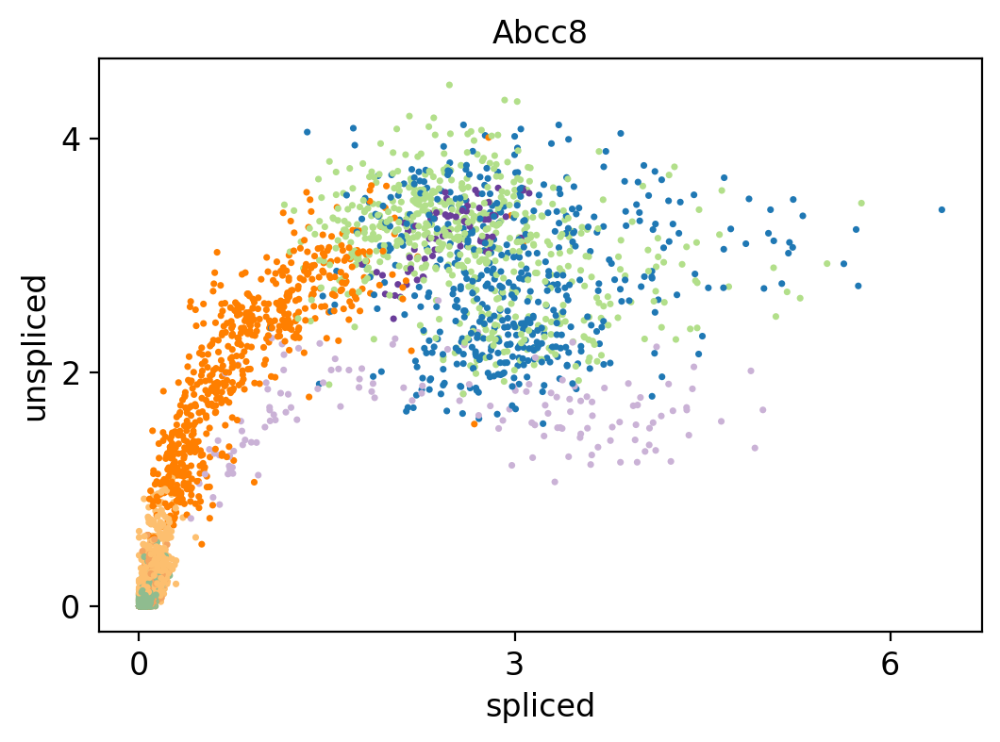

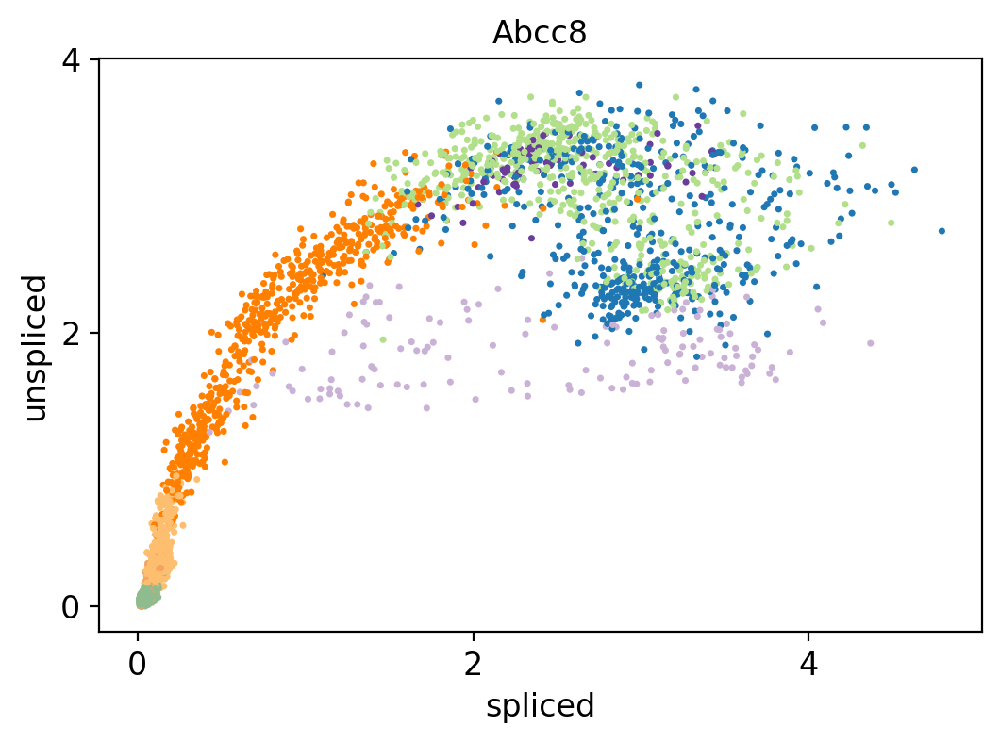

In [33]:
scv.pl.scatter(adata_nn_30, ['Abcc8'], color='clusters')
scv.pl.scatter(adata_nn_100, ['Abcc8'], color='clusters')

In the end we continue with the default value of 30 neigbors as it allows to see the pattern of induction/repression in the first- and second-order moments without overfitting. 

If we use too few neighbors (`k=10`), the result is a nosiy blob in the middle, which makes it difficult to inffer meaningful biological information. Too many neighbors (`k=300`) produces unnatural results - it completely smoothes out the variance. Even with less neghbors, `k=100`, it can produce artifacts like in the case of Abcc8. The default value of `k=30` seems to work fine, since already at this point we can see the patterns of induction and repression. 

<img src="Screenshot.png" alt="Phase portrait" style="width: 200px;"/>

In [19]:
adata = adata_nn_30

# Milestone 4: Velocity estimation 

*4.1. For velocity estimation, per default the stochastic model is applied. It estimates the steady-state ratio for each gene, and computes velocities as the residuals of the observations from this steady-state line.*

*4.2. Demonstrate for a few genes, how the steady-state line is fit. Can you show mathematically why velocities are given as the residuals from this line?*

*4.3. Now, apply the dynamical model instead and show how the steady-state lines differ.*

*4.4. Now use a few gene phase portraits to demonstrate how inferred up- and down-regulation can be read from these portraits.*

*4.5. What are transient states as opposed to steady states? How many steady states exist?*

We compute the velocity. The full dynamical model can be obtained by setting `mode='dynamical'`, it is however, very time consuming to run. Therefore, we first test the default `stochastic` mode, which allows for good approximation of the full model results. 

In [20]:
scv.tl.velocity(adata)

computing velocities
    finished (0:00:10) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


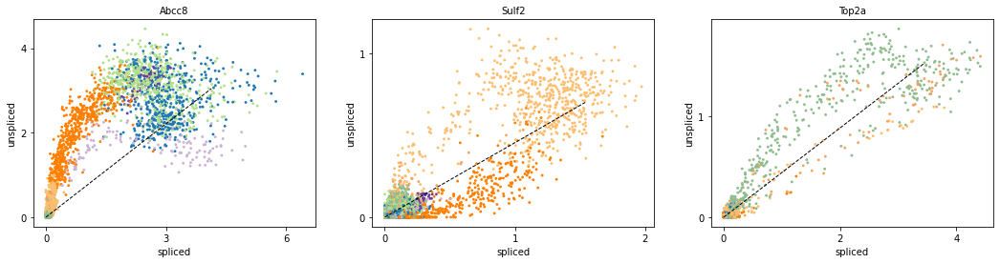

In [21]:
scv.pl.scatter(adata, ['Abcc8', 'Sulf2', 'Top2a'], color='clusters')

Rate equations for a single gene, which describes how  the  expected  number  of  unspliced  mRNA  molecules  𝑢,  and
spliced molecules 𝑠, evolve over time:

<img src="Screenshot1.png" alt="Phase portrait" style="width: 200px;"/>

Here, 𝛼(𝑡) is the time-dependent rate of transcription, 𝛽(𝑡) is the rate of splicing, 𝛾(𝑡) is the rate
of  degradation.  Under  an  assumption  of  constant  (time-independent)  rates  𝛼(𝑡) = 𝛼,  𝛾(𝑡) = 𝛾,
and  setting  𝛽(𝑡) = 1  (i.e.  measuring  all  rates  in  units  of  the  splicing  rate),  the  rate  equations
simplify to:

<img src="Screenshot2.png" alt="Phase portrait" style="width: 150px;"/>

$\gamma s(𝑡)$ is the steady state line and $u(𝑡)$ is the observed amount of unspliced counts. Therefore velocity is the residual between $u(t)$ and the steady state line. 

To try if we can get a better fit of the steady-state line, we now use the full dynamical model. 

In [23]:
scv.tl.recover_dynamics(adata, n_jobs=4)

recovering dynamics (using 4/64 cores)


  0%|          | 0/2290 [00:00<?, ?gene/s]

    finished (0:04:53) --> added 
    'fit_pars', fitted parameters for splicing dynamics (adata.var)


In [24]:
scv.tl.velocity(adata, mode='dynamical')

computing velocities
    finished (0:00:16) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


We look at the genes which show up-regulation, meaning increased number of cells in the inducation phase. 

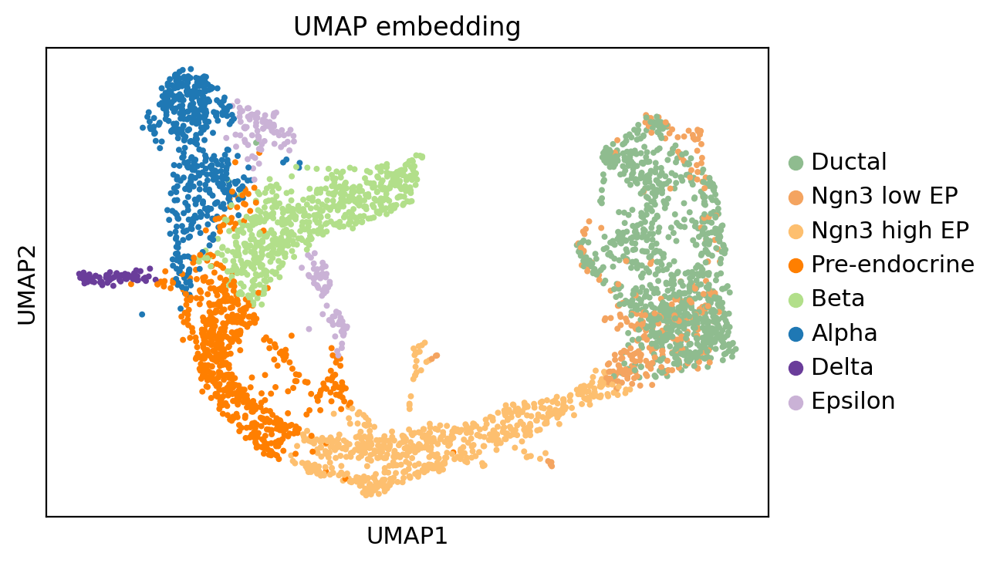

In [34]:
sc.tl.umap(adata)
sc.pl.umap(adata, color='clusters', title='UMAP embedding')

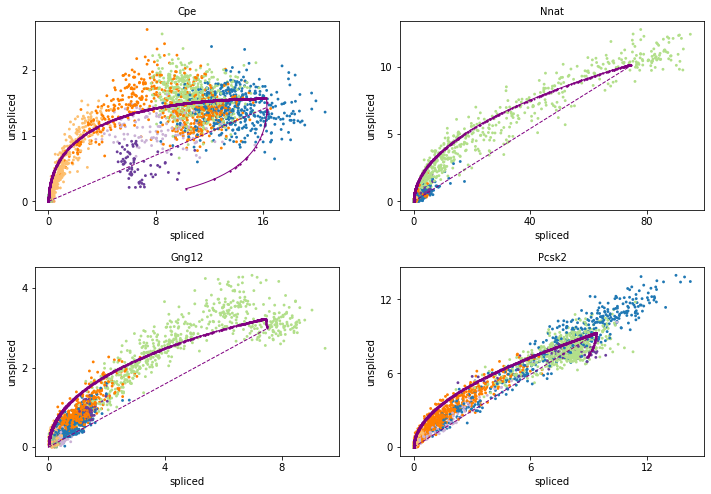

In [25]:
scv.pl.scatter(adata, ['Cpe', 'Nnat', 'Gng12', 'Pcsk2'], color='clusters', ncols=2)

In a simialr way we can also detect down-regulated genes, with more cells in the repression phase. 

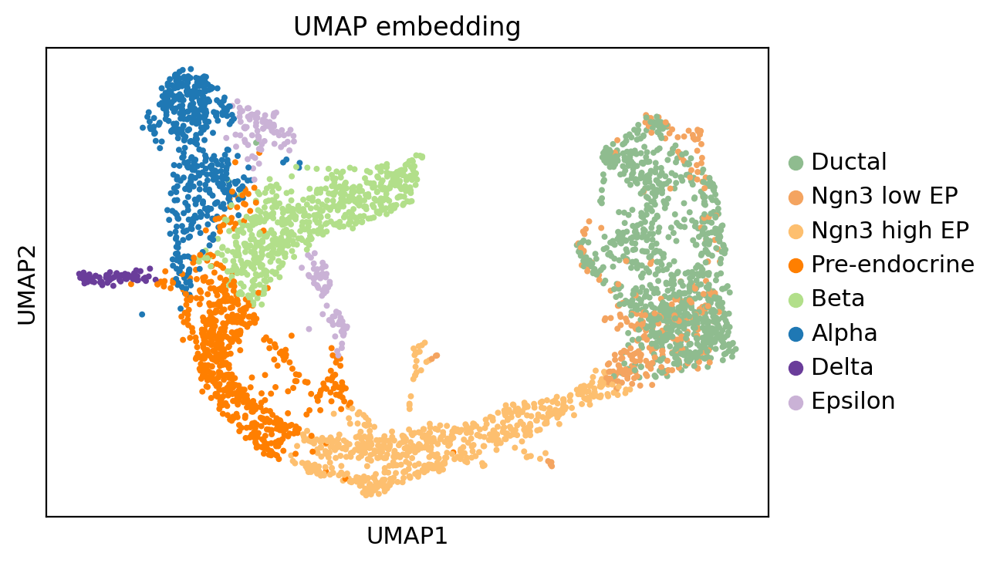

In [35]:
sc.pl.umap(adata, color='clusters', title='UMAP embedding')

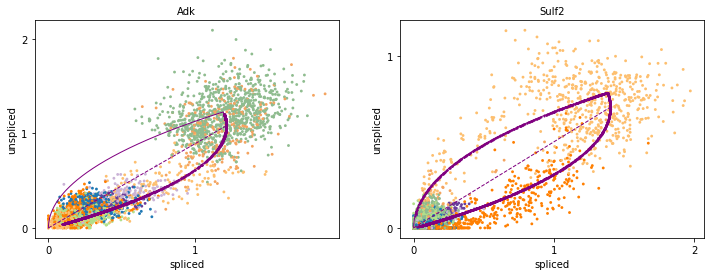

In [26]:
scv.pl.scatter(adata, ['Adk', 'Sulf2'], color='clusters')

The original model of RNA velocity, the deterministic model, assumes one splicing rate common for all of the genes ($\beta = 1$). This means that the model only fits the two steady states (active and inactive). In contrast, the dynamical model also calculates the transient states, induction and repression (along with the two steady states). Those two additional transient states are determined based on gene-specific transcriptional rates, from which a likelihood-dynamic model is built on a gene-shared latent time. This allows for a more comprehensive and faithful representation of the underlying gene dynamics. It more accuarately models the heterogeneity of celltypes and gene expression patterns in a dataset.  

# Milestone 5: Embeddings 

*5.1. Compute various dimensionality reduction methods / embeddings (e.g., tsne, umap, diffmap) and show how they differ and what type of topology they capture (local vs. global similarity).*

*5.2. As you vary the main parameters (e.g., min_dist in umap), how does that impact the embedding?*

*5.3. Which of these embeddings would you use for visualising trajectories and why?*

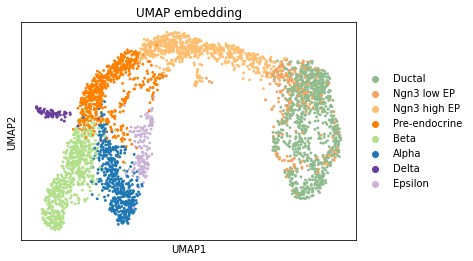

In [27]:
sc.tl.umap(adata)
sc.pl.umap(adata, color='clusters', title='UMAP embedding')

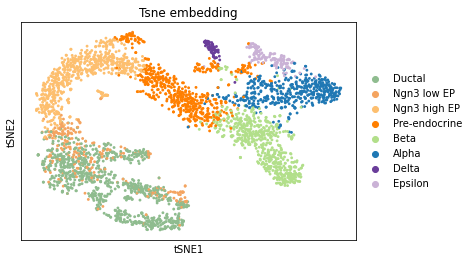

In [28]:
sc.tl.tsne(adata)
sc.pl.tsne(adata, color='clusters', title='Tsne embedding')

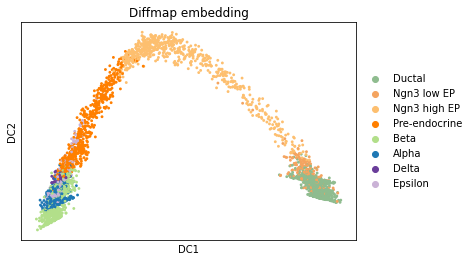

In [29]:
sc.tl.diffmap(adata)
sc.pl.diffmap(adata, color='clusters', title='Diffmap embedding')

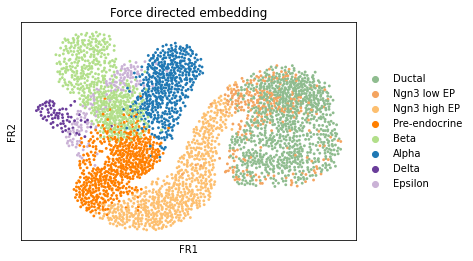

In [30]:
sc.tl.draw_graph(adata)
sc.pl.draw_graph(adata, color='clusters', title='Force directed embedding')

Embedding calculations offer parameters which we can modify. Depending on the type of embedding the parameters may affect different aspects of the embedding creation. In the case of UMAP, the two parameters, `min_dist` and `spread`, control how far spread out the cells are from each other.

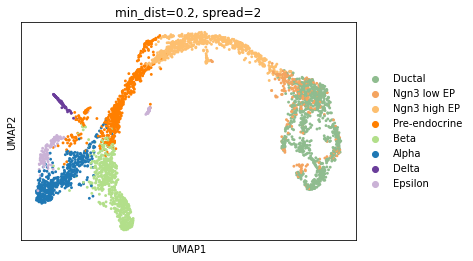

In [31]:
sc.tl.umap(adata, min_dist=0.2, spread=2)
sc.pl.umap(adata, color='clusters', title='min_dist=0.2, spread=2')

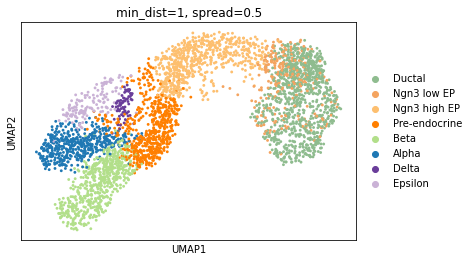

In [32]:
sc.tl.umap(adata, min_dist=1, spread=0.5)
sc.pl.umap(adata, color='clusters', title='min_dist=1, spread=0.5')

Lowering the spread parameter forces the cells more in-line with the global topology, but get rids of some of the finer local structers. For example, the ductal cells loose the circular pattern of cell cycle. We should evaluate the results keeping in mind the underlying biology of the dataset and how well the results represent it. 

Tsne captures well the local topology of the dataset, but fails at accurately representing the global structures.  

Embeddings like diffmap (`tl.diffmap`) or the force-directed graph drawing (`tl.draw_graph`) are the best for visualising trajectories, because they focus the most on capturing the global topolgy by sacryficing local differneces between cells. 

UMAP is a good middle ground between local and global structure. UMAP parameters can be further tweaked to better represent specific features of the respective datasets. 

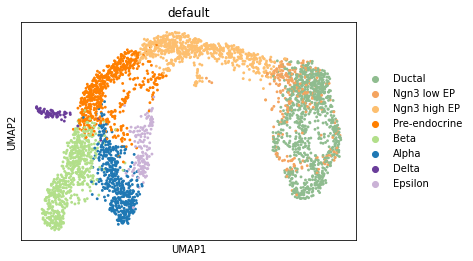

In [66]:
sc.tl.umap(adata)
sc.pl.umap(adata, color='clusters', title='default')

# Milestone 6: Velocity graph 

*6.1. The velocity graph summarises all cell-to-cell transitions inferred from velocity. What exactly does the ij-th entry in the graph represent?*

*6.2. Can you run a number of cell transitions using the graph to simulate a trajectory starting from a particular cell in one of the embeddings?*

*6.3. How do the trajectories compare, when run from different starting cells (e.g., cell cycle vs. differentiation)?*

In [67]:
scv.tl.velocity_graph(adata)

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:18) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


The velocity graph is a graph of cell-to-cell transitions inferred from velocity. For two cells, $i$ and $j$, it represents cosine similarities between velocity vector $v_i$ and gene expression change $x_j - x_i$.

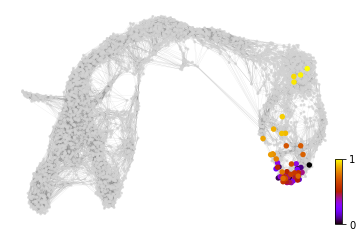

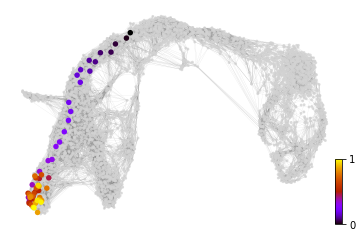

In [72]:
# NB! Due to the randomness of the transition path selection, the trajectories may look different between runs of the code
seed = 120
root_cell_cc = np.flatnonzero(adata.obs['clusters'] == 'Ductal')[1]
root_cell_diff = np.flatnonzero(adata.obs['clusters'] == 'Ngn3 high EP')[0]

x, y = scv.utils.get_cell_transitions(adata, basis='umap', starting_cell=root_cell_cc, random_state=seed)
ax = scv.pl.velocity_graph(adata, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(adata, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

x, y = scv.utils.get_cell_transitions(adata, basis='umap', starting_cell=root_cell_diff, random_state=seed)
ax = scv.pl.velocity_graph(adata, c='lightgrey', edge_width=.05, show=False)
ax = scv.pl.scatter(adata, x=x, y=y, s=120, c='ascending', cmap='gnuplot', ax=ax)

At basal developmental stages cells can display more locally confined trajectories without clear transitions into other celltypes/clusters, indicating cell cycle-related velocity. Cells from more developmentally advanced clusters will usualy exhibit a more clear trajectory towards more mature/terminally differentiated cell types.

# Milestone 7: Velocity projection 

*7.1. Now the high-dimensional velocity vector field is visualized by projection into the two-dimensional embedding. Show how the velocity graph (transition matrix) is being used to project the data. For instance, you can pick one particular cell, and show its potential transitions, and how the actual arrow is derived from these.*

*7.2. Vary with the n_neighbors parameter and show how that impacts the projected vector field.*

*7.3. Why is the vector field getting smoother/averaged with a large n_neighbors parameter?*

In [4]:
scv.settings.set_figure_params(dpi=300)

In [2]:
adata = sc.read('afterTuesday.h5ad')

computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


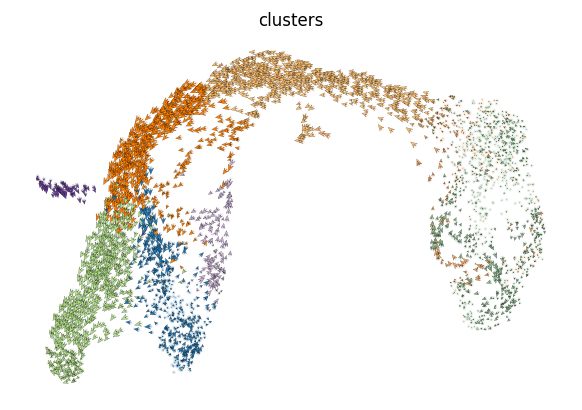

In [3]:
scv.pl.velocity_embedding(adata, arrow_length=3, arrow_size=2, dpi=120)

We pick a random `selected_cell` from a `cluster` and visualise the transition probabilities (`trans`) for that cell.

This one cell from Ngn3 high cluster have the high probability transitions very focused in the immediate neighbourhood along the differentation trajectory.

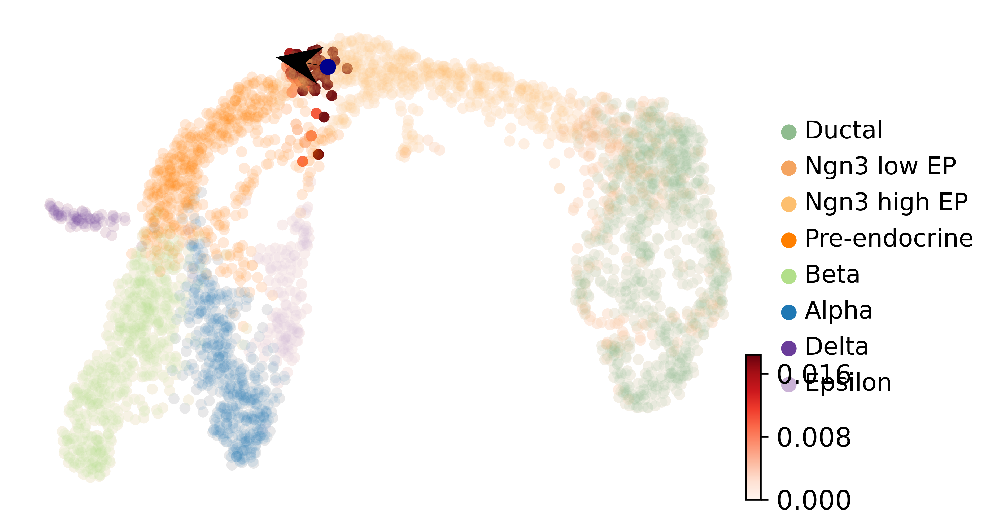

Variance:  0.5808679


In [5]:
cluster = 'Ngn3 high EP'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[0]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

To measure differentiation potential of a given cell we calculate variance on the UMAP coordinates cells with high transition probabilites. 

On the other hand, this other cell have a much larger (further) transition. Again, the cell transitions outside its own cluster.

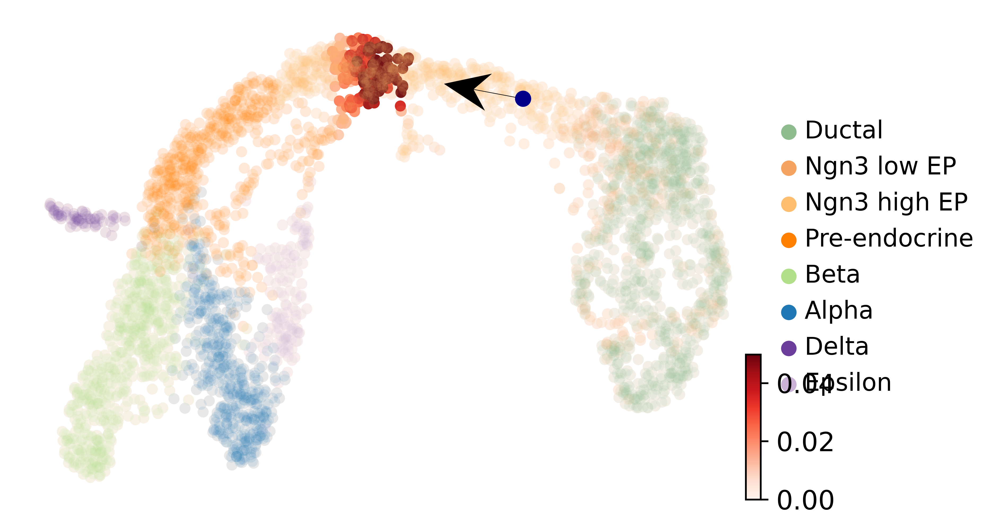

Variance:  1.0102584


In [6]:
cluster = 'Ngn3 high EP'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[4]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

On the other hand, some of the Ductal cells fall into the cell cycle loop and stay in their own cluster.

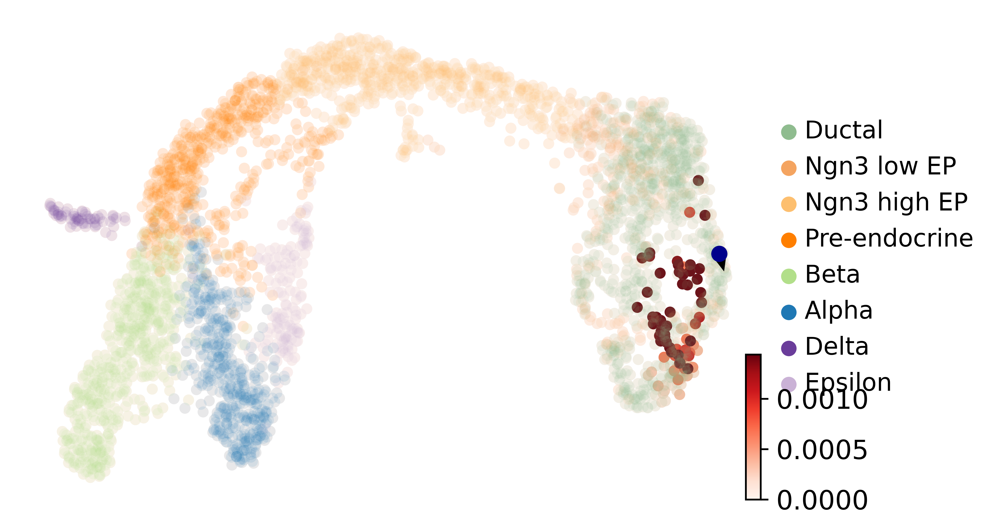

Variance:  0.8556868


In [7]:
cluster = 'Ductal'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[1]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

Delta cells stay in the delta cluster.

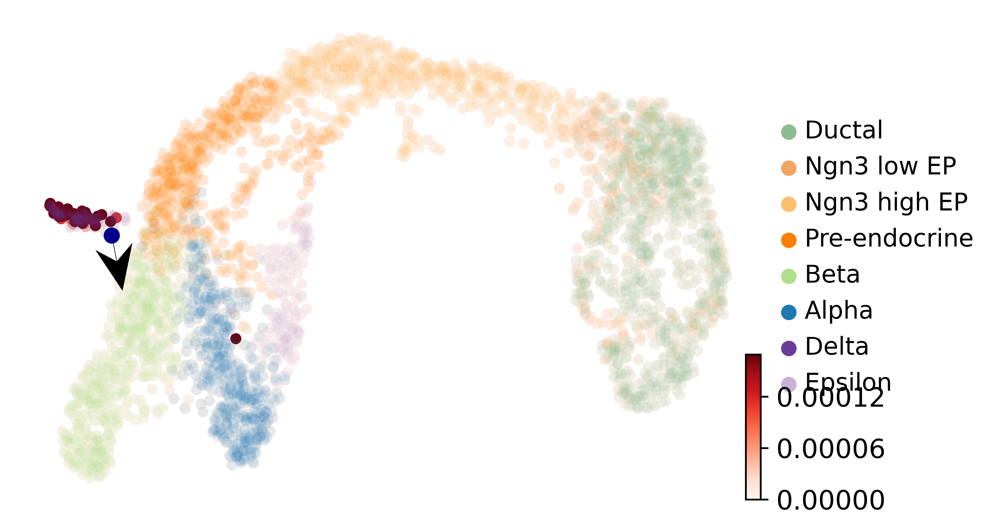

Variance:  0.8093915


In [8]:
cluster = 'Delta'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[0]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

Altough some have a high probabilty going against their cell fate.

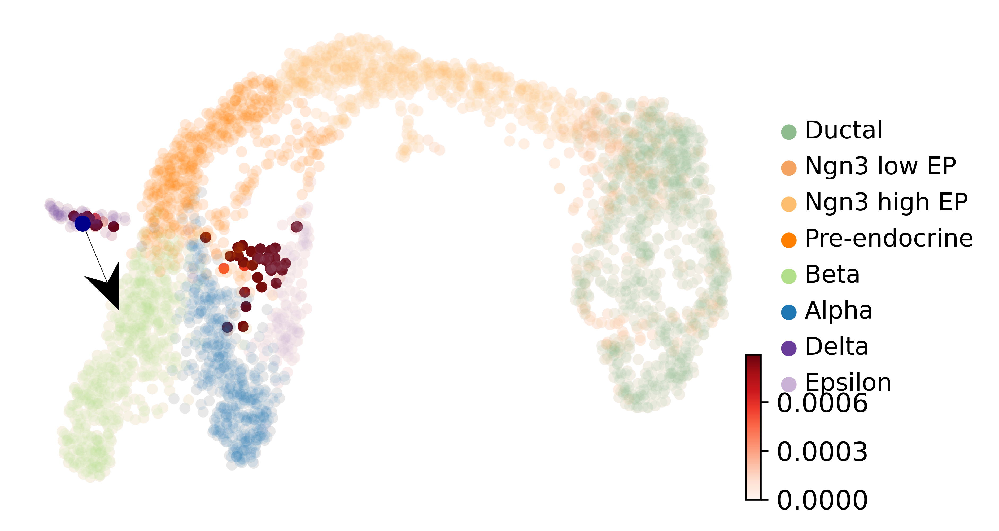

Variance:  2.806449


In [9]:
cluster = 'Delta'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[1]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

Some cells have a probability of transitioning into multiple states. 

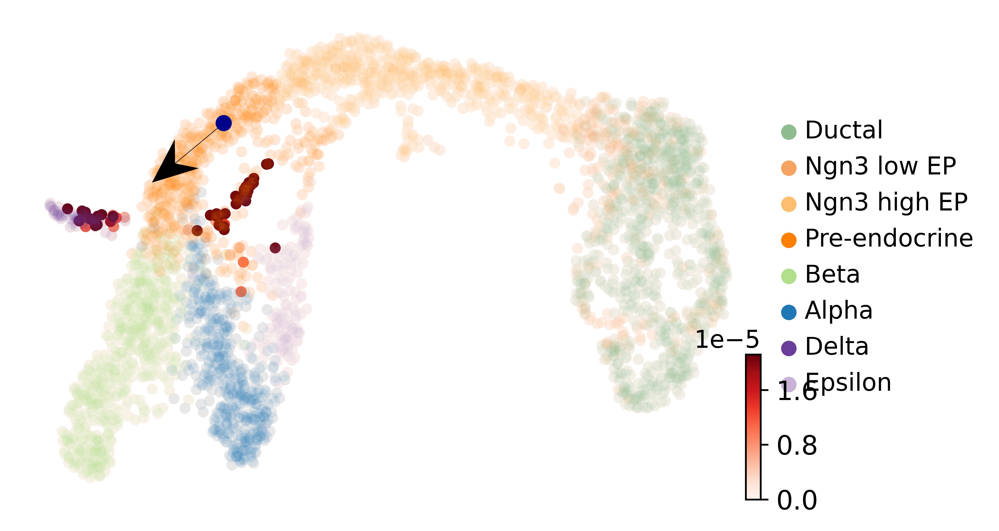

Variance:  2.1123424


In [10]:
cluster = 'Pre-endocrine'
selected_cell = np.flatnonzero(adata.obs['clusters'] == cluster)[42]
trans = scv.utils.get_transition_matrix(adata).todense()

ax = scv.pl.scatter(adata[adata.obs['clusters'] == cluster], color=selected_cell, show=False, alpha=0, size=20)
ax = scv.pl.scatter(adata, color=trans[:,selected_cell], show=False, cmap='Reds', alpha=1, perc=99, ax=ax, size=100)
ax = scv.pl.scatter(adata, color='clusters', alpha=0.1, ax=ax, size=100, legend_loc='right margin', title='', show=False)
ax = scv.pl.velocity_embedding(adata[adata.obs['clusters'] == cluster][selected_cell], color='black', ax=ax, size=0, arrow_length=30, arrow_size=10)

trans_cells = trans[:,selected_cell] > 0
x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

x_center = (x - x.mean())
y_center = (y - y.mean())

variance_x = np.var(x_center)
variance_y = np.var(y_center)
print("Variance: ", np.mean([variance_x, variance_y]))

The code below can be used to calculate the variance for all the cells in the dataset. Because it contains a loop through all the cells, it crushes the AWS instance. Therefore run it only on your own machine. 

In [ ]:
trans = scv.utils.get_transition_matrix(adata).todense()
variance_array = []

for selected_cell in range(len(adata.obs_names)):
    # Keep only cells with positive transition probability
    trans_cells = trans[:,selected_cell] > 0.0001
    # Remove the selected cell itself
    trans_cells[selected_cell] = False
    x = np.array(adata[trans_cells].obsm['X_umap'][:,0])
    y = np.array(adata[trans_cells].obsm['X_umap'][:,1])

    x_center = (x - x.mean())
    y_center = (y - y.mean())

    variance_x = np.var(x_center)
    variance_y = np.var(y_center)
    variance_mean = np.mean([variance_x, variance_y])
    variance_array.append(variance_mean)

variance_array_nonan = np.nan_to_num(variance_array)
adata.obs['transition_variance'] = variance_array_nonan
sc.pl.umap(adata, color='transition_variance', cmap='YlOrRd')

In [290]:
scv.settings.set_figure_params(dpi=150)

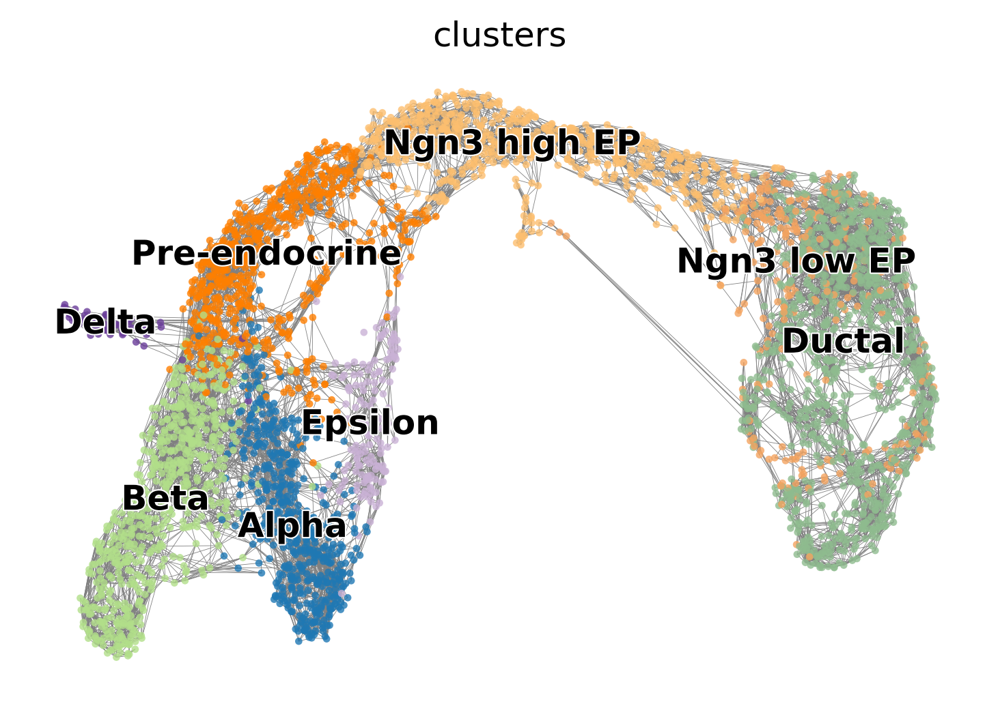

In [292]:
scv.pl.velocity_graph(adata, color='clusters', n_neighbors=3)

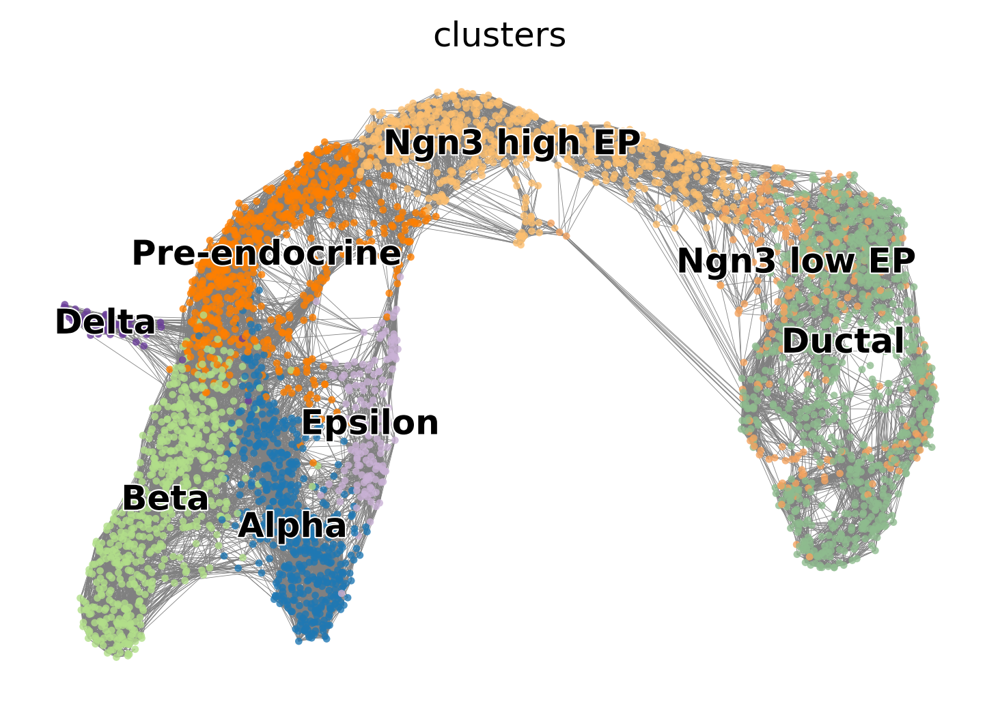

In [293]:
scv.pl.velocity_graph(adata, color='clusters', n_neighbors=10)

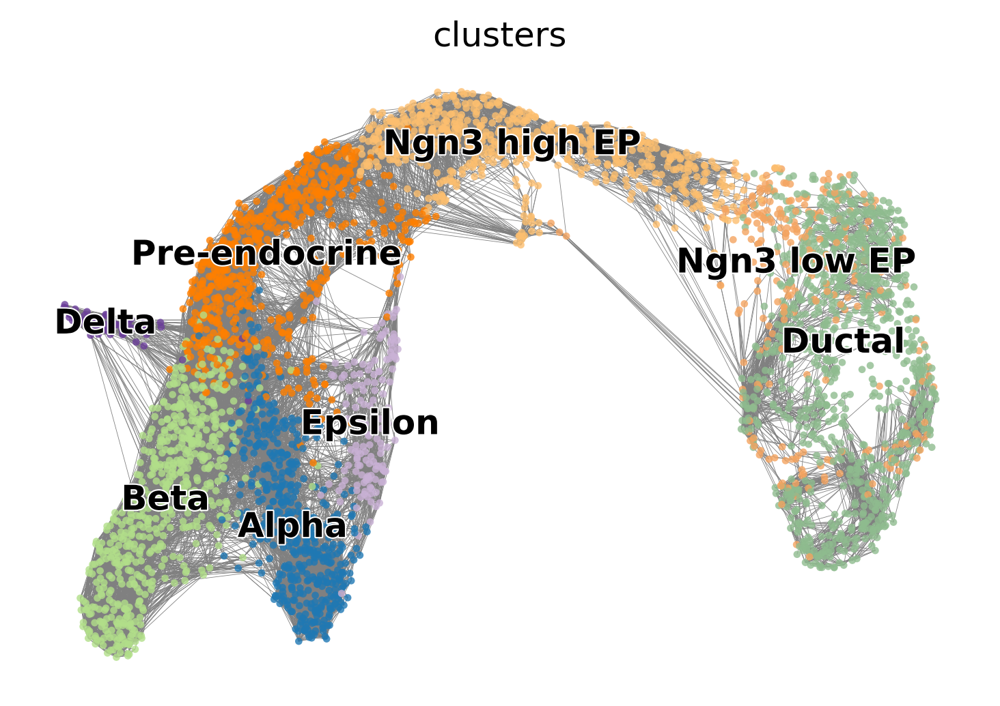

In [294]:
scv.pl.velocity_graph(adata, color='clusters', n_neighbors=100)

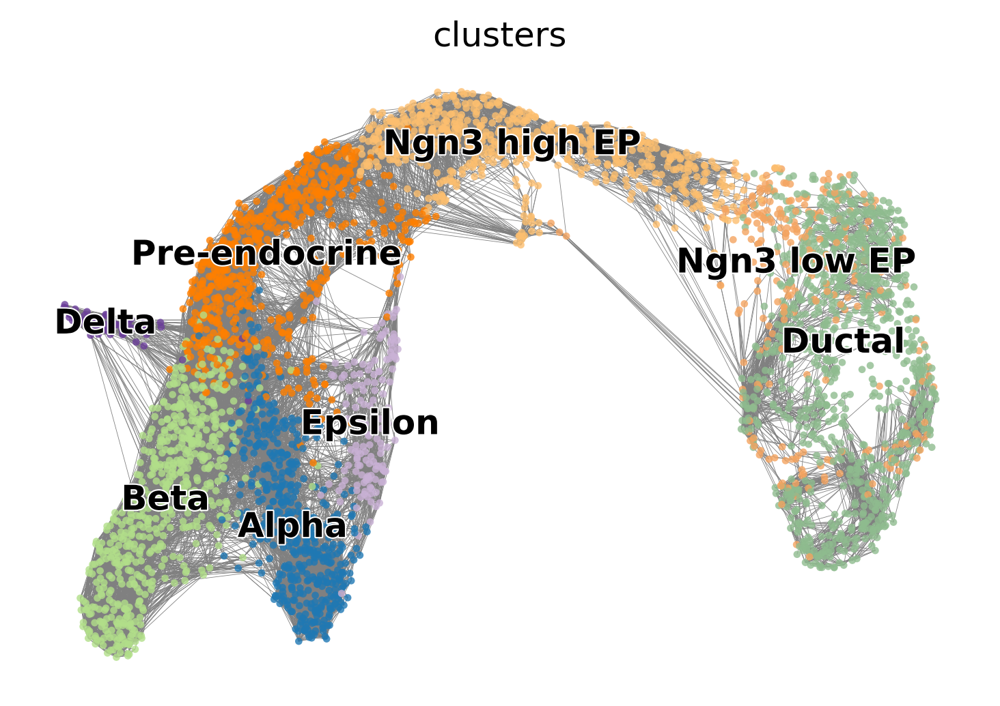

In [295]:
scv.pl.velocity_graph(adata, color='clusters', n_neighbors=500)

The vector field getting smoother/averaged with a large n_neighbors parameter, because it increases the requirement for connectivities based on the neighborhood graph, converging the vectors and therefore smoothing them.

# Milestone 8: Topic 2 - Identification of putative driver genes 

*8.1.1. Identification of dynamically relevant genes is motivated in three ways:*

*8.1.2. We would like to understand, which genes are the ones that drive the vector field representation in the embeeding, i.e., which are most impactful on the projection.*

*8.1.3. We would like to understand, which gene are transiently expressed, i.e., dynamically activating in the differentiation process.*

*8.1.4. Finally, we want to know which genes are actual driver of the underlying biological processes.*

*8.1.5. Using only a small number of selected genes, show how the velocity projection differs from the projection using all genes. Can you quantify that difference?*

*8.1.6. There are different ways of computing ‘relevant’ genes in scvelo. Show, which of them best represents the entire vector field.*

*8.1.7. Which genes are supporting / contradicting the embedded trajectories? How does the projection differ, as you subset to these genes or exclude these genes?*

*8.1.8. Find more ways of identifying important genes, e.g., using PCA on the velocity vector field.*

In [2]:
scv.settings.set_figure_params(dpi=150)

In [3]:
adata = sc.read('afterTuesday.h5ad')

In [11]:
scv.tl.rank_velocity_genes(adata, groupby='clusters', min_corr=.3)

df = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])
df.head(n=10)

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,Ductal,Ngn3 low EP,Ngn3 high EP,Pre-endocrine,Beta,Alpha,Delta,Epsilon
0,Veph1,Notch2,Ptprs,Scg5,Rims3,Sorcs2,Ncor2,Prdx4
1,Creb5,Itgb6,Ajap1,Syt7,Col6a6,Rasgrf2,Spsb4,Pdk2
2,Notch2,Veph1,Tecr,Sez6l2,Ism1,Mctp2,Hat1,Mctp2
3,Lamc1,Creb5,Gm43938,Abcc8,Slc31a2,Skap1,P2ry1,Glce
4,Sh3tc2,Gm11266,Fam151a,Tfap2b,Kctd8,Sv2b,Ambp,Rab27a
5,Itgb6,Knop1,Runx1t1,Pcsk2os1,Slc16a9,Trpc5,Pygl,Vgll4
6,Vtcn1,Hspa8,Gsg1l2,Pcsk2,Sdk2,Slc41a2,Sorcs2,Spsb4
7,Msi2,Acly,Sel1l,Baiap3,Pgpep1l,Nfasc,Pdia5,Ivd
8,5730559C18Rik,Fndc3b,Vwa5b2,Slc38a11,Sphkap,Ube2u,Clic6,Syt13
9,Plaur,Rbbp8,Mtch1,Rab27a,A830011K09Rik,Zbtb7c,Acat1,Rimbp2


computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:14) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


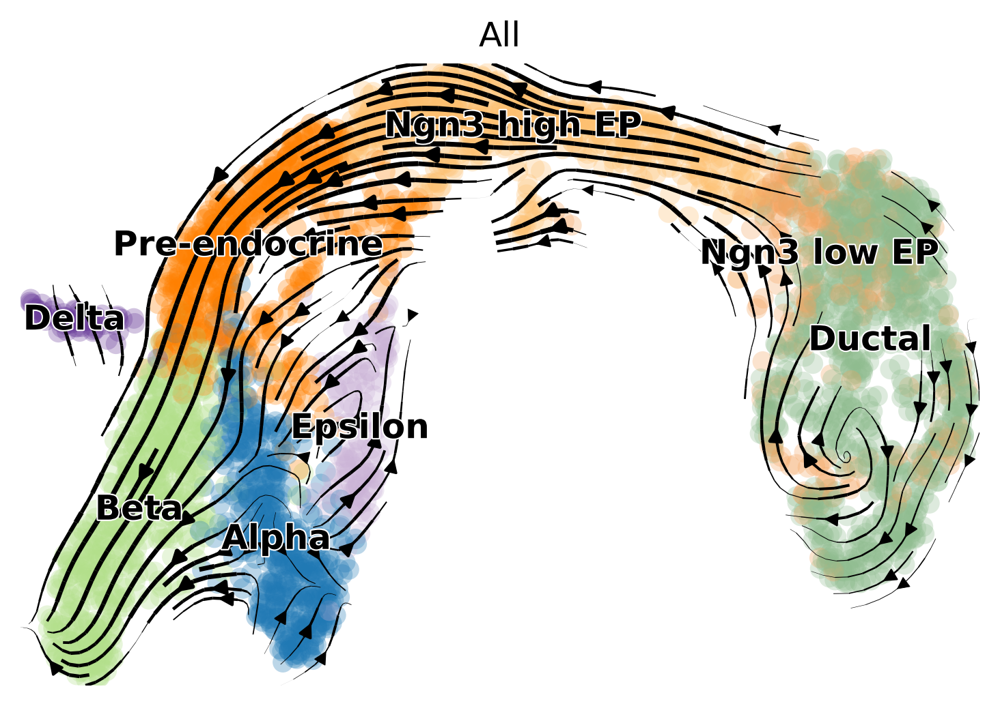

In [5]:
scv.tl.velocity_graph(adata)
adata.uns['velocity_graph_all'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, title='All')

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


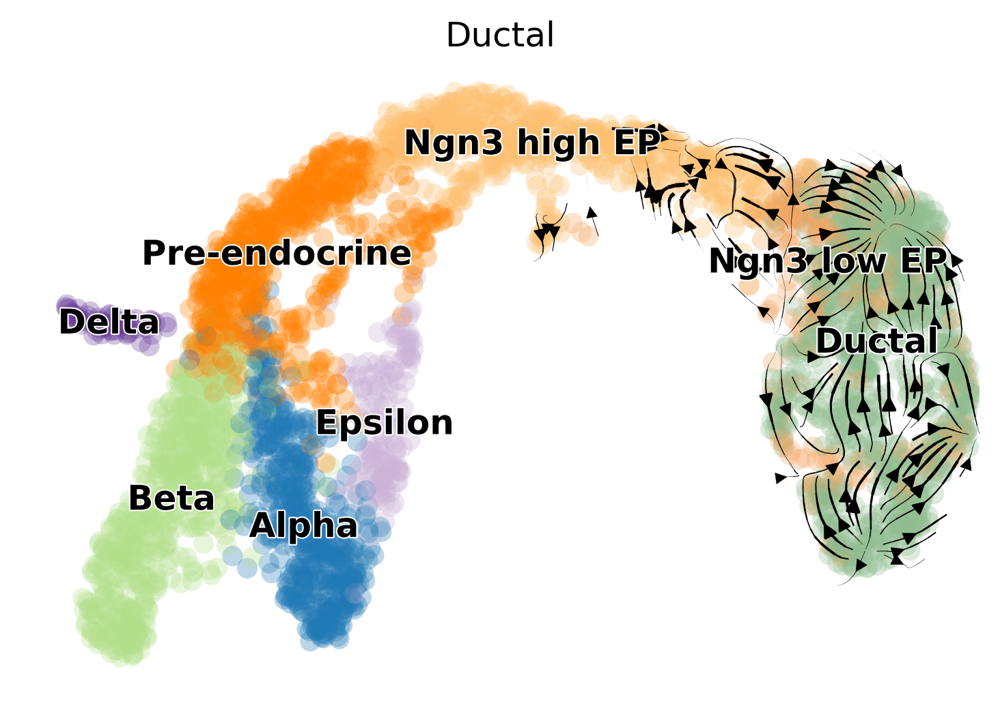

In [6]:
scv.tl.velocity_graph(adata, gene_subset=['Veph1','Creb5'])
adata.uns['velocity_graph_ductal'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, title='Ductal')

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


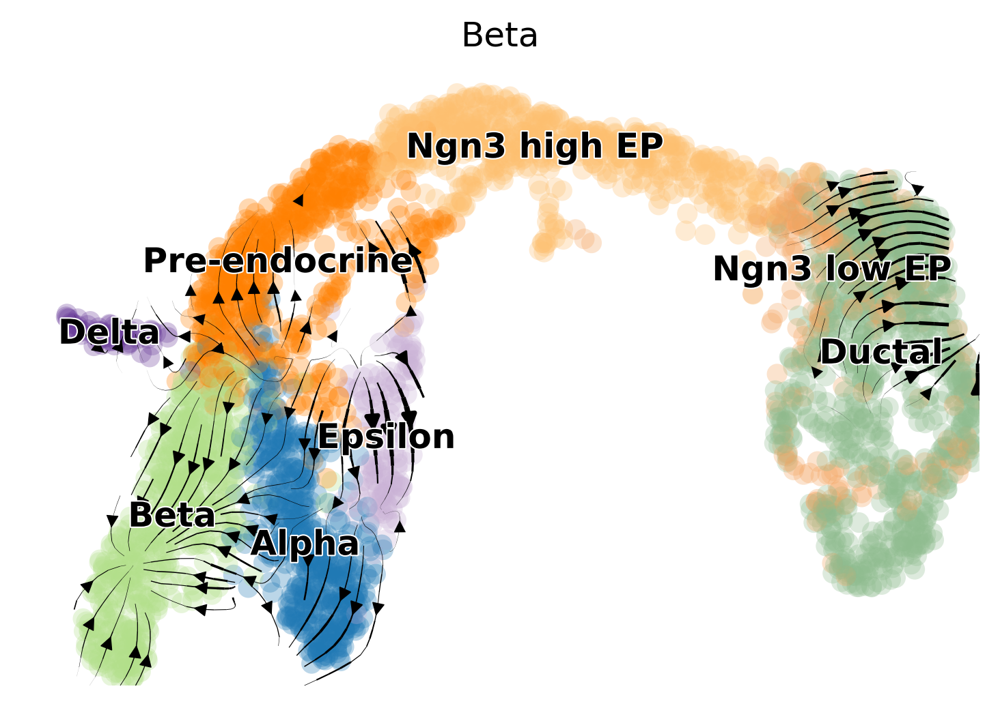

In [7]:
scv.tl.velocity_graph(adata, gene_subset=['Rims3','Col6a6'])
adata.uns['velocity_graph_beta'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, title='Beta')

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


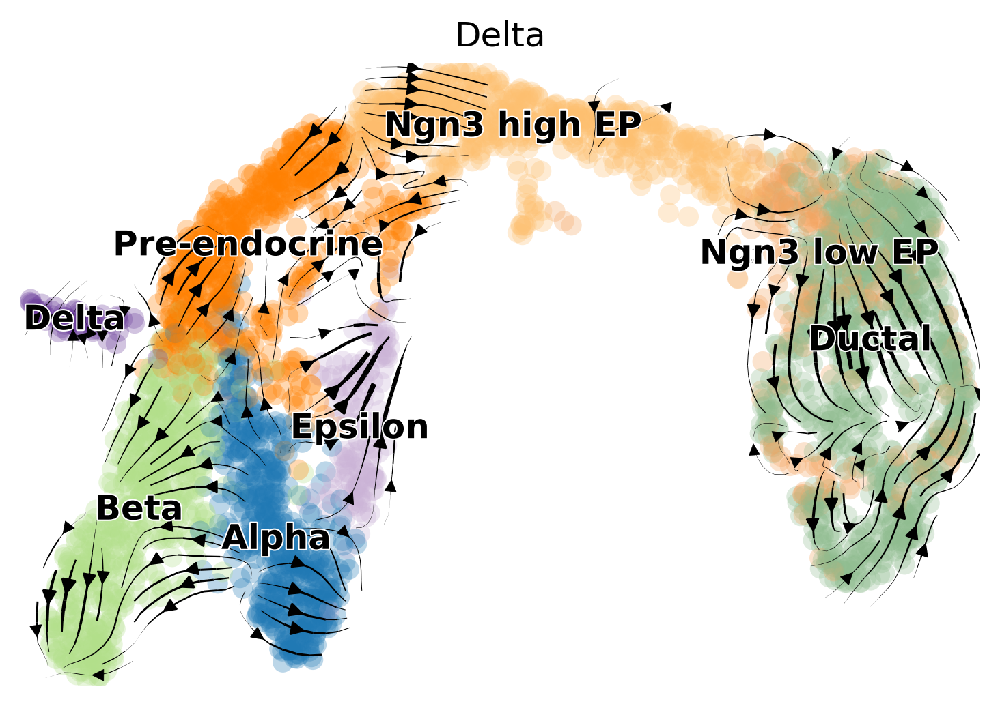

In [8]:
scv.tl.velocity_graph(adata, gene_subset=['Ncor2','Spsb4'])
adata.uns['velocity_graph_delta'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, title='Delta')

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


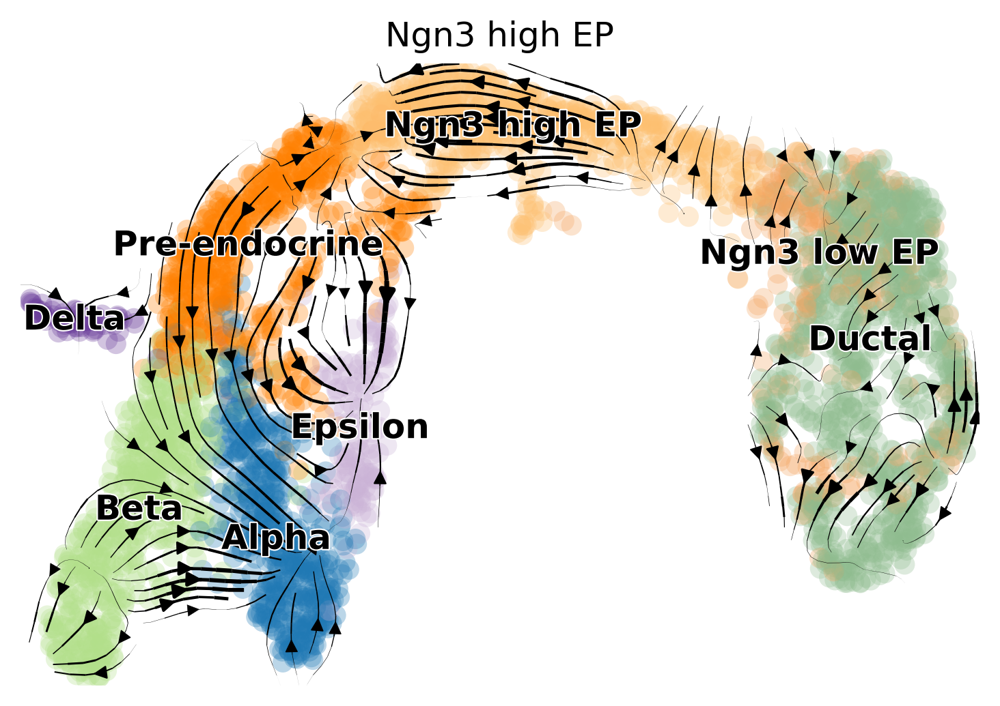

In [9]:
scv.tl.velocity_graph(adata, gene_subset=['Ptprs','Ajap1'])
adata.uns['velocity_graph_ngn3HIGH'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, title='Ngn3 high EP')

In [10]:
adata

AnnData object with n_obs × n_vars = 3696 × 27997
    obs: 'clusters_coarse', 'clusters', 'S_score', 'G2M_score', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition'
    var: 'highly_variable_genes', 'gene_count_corr', 'velocity_gamma', 'velocity_qreg_ratio', 'velocity_r2', 'velocity_genes', 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'fit_variance', 'fit_alignment_scaling', 'fit_r2', 'spearmans_score', 'velocity_score'
    uns: 'clusters_coarse_colors', 'clusters_colors', 'day_colors', 'diffmap_evals', 'draw_graph', 'neighbors', 'pca', 'recover_dynamics', 'umap', 'velocity_graph', 'velocity_graph_neg', 'velocity_params', 'rank_velocity_genes', 'velocity_graph_all', 'velocity_graph_ductal', 'velocity_graph_beta', 'velocity_graph_delta', 'velocity_graph_ngn3HIGH'
    obsm: 'X_diffmap', 'X_draw_graph_fr'

In [28]:
df_dict = {}
for uns in adata.uns:
    if uns.startswith('velocity_graph_'):
        if uns != 'velocity_graph_neg':
            df = scv.get_df(adata, keys=[uns])
            df_dict[uns] = df

In [29]:
corr_df_dict = {}
for keys, df in df_dict.items():
    if keys != 'velocity_graph_all':
        corr = df_dict[keys].corrwith(df_dict['velocity_graph_all'])
        corr_df_dict[keys] = corr

In [30]:
for key in corr_df_dict:
    adata.obs[key] = corr_df_dict[key].to_numpy()

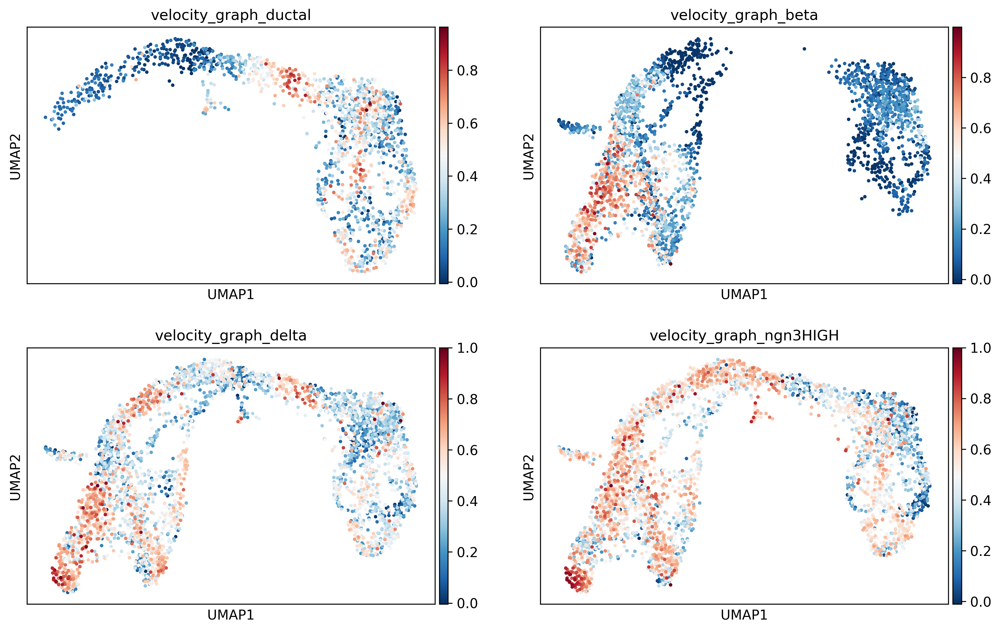

In [32]:
sc.pl.umap(adata, color=corr_df_dict.keys(), ncols=2)

In [294]:
corr_df_merged = pd.concat(corr_df_w_index, axis=1, join='inner')

In [295]:
corr_df_merged.columns = corr_df_merged.columns.droplevel()

In [296]:
corr_df_merged = corr_df_merged.loc[:,~corr_df_merged.columns.duplicated()]

In [297]:
corr_df_merged = corr_df_merged.set_index('clusters', drop=True)

In [300]:
corr_df_merged = corr_df_merged.sort_index(ascending=True)

In [301]:
corr_df_merged

,velocity_graph_ductal,velocity_graph_alpha,velocity_graph_Pendocrine,velocity_graph_top_con
clusters,,,,
Ductal,0.665527,0.000000,0.310244,0.705518
Ductal,0.766988,0.087006,0.328803,0.532104
Ductal,0.792934,0.793352,0.748158,0.597168
Ductal,0.302477,0.181053,0.379072,0.432768
Ductal,0.836068,0.814529,0.677657,0.617500
...,...,...,...,...
Epsilon,0.000000,0.465183,0.562949,0.544158
Epsilon,0.000000,0.687445,0.650325,0.500199
Epsilon,0.000000,0.561465,0.298058,0.122740


In [302]:
# Order by latent time / clusters

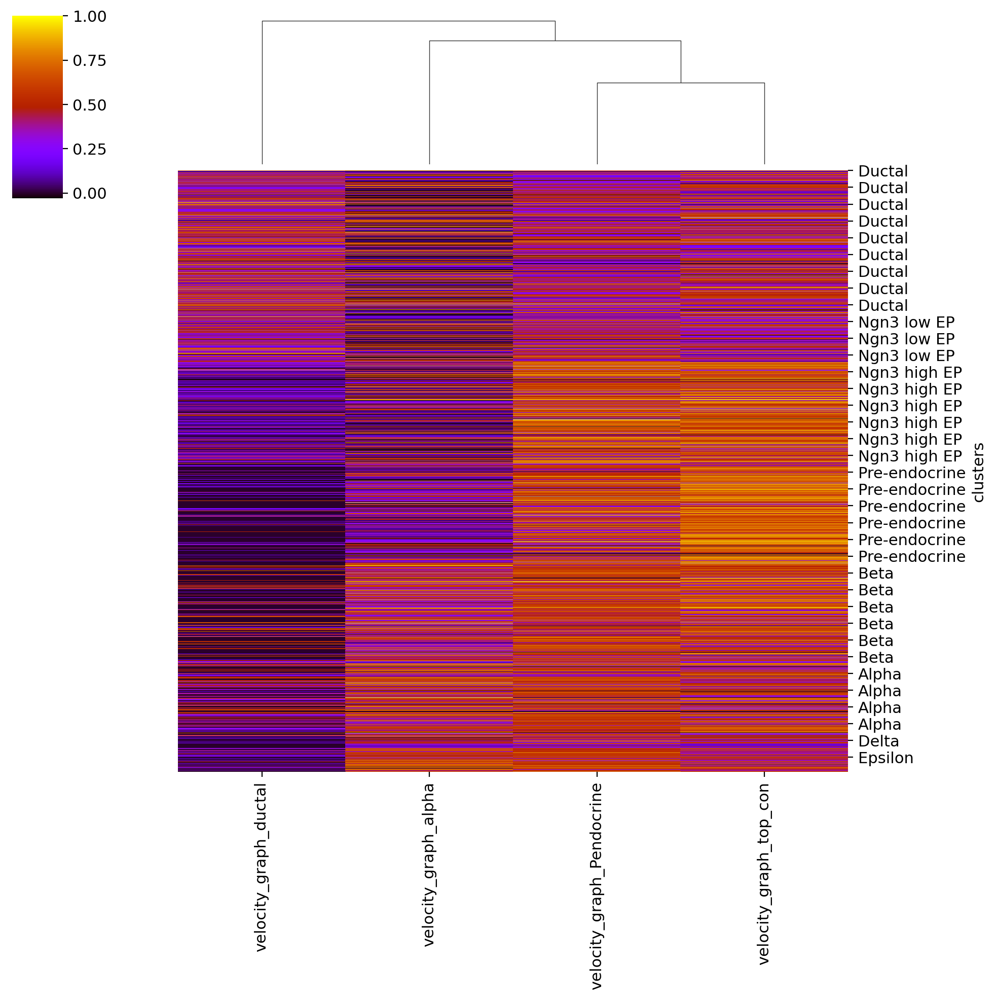

In [305]:
import seaborn as sns
sns.clustermap(corr_df_merged, cmap='gnuplot', row_cluster=False)
plt.show()

In [3]:
# Calculate dynamic genes
scv.tl.rank_dynamical_genes(adata, groupby='clusters')
df = scv.get_df(adata, 'rank_dynamical_genes/names')

# calculate velocity genes
scv.tl.rank_velocity_genes(adata, groupby='clusters', min_corr=.3)
df2 = scv.DataFrame(adata.uns['rank_velocity_genes']['names'])


ranking genes by cluster-specific likelihoods
    finished (0:00:01) --> added 
    'rank_dynamical_genes', sorted scores by group ids (adata.uns)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


In [4]:
# Extract top 5 dynamic genes per cluster
dyn5Genes = []

for cluster in df:
    for gene in df[cluster][0:5].tolist():
        dyn5Genes.append(gene)


In [5]:
# Extract top 5 velocity genes per cluster
velo5Genes = []

for cluster in df2:
    for gene in df2[cluster][0:5].tolist():
        velo5Genes.append(gene)

In [6]:
# Velocity embedding based on top 5 dynamic genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(dyn5Genes))) 
adata.uns['velocity_graph_top5_dynGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [7]:
# Velocity embedding based on top 5 velocity genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(velo5Genes))) 
adata.uns['velocity_graph_top5_veloGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [8]:
# Extract top 10 dynamic genes per cluster
dyn10Genes = []

for cluster in df:
    for gene in df[cluster][0:10].tolist():
        dyn10Genes.append(gene)

In [9]:
# Extract top 10 velocity genes per cluster
velo10Genes = []

for cluster in df2:
    for gene in df2[cluster][0:10].tolist():
        velo10Genes.append(gene)

In [10]:
# Velocity embedding based on top 10 dynamic genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(dyn10Genes))) 
adata.uns['velocity_graph_top10_dynGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [11]:
# Velocity embedding based on top 10 velocity genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(velo10Genes))) 
adata.uns['velocity_graph_top10_veloGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [12]:
# Extract top 30 dynamic genes per cluster
dyn30Genes = []

for cluster in df:
    for gene in df[cluster][0:30].tolist():
        dyn30Genes.append(gene)

In [13]:
# Extract top 30 velocity genes per cluster
velo30Genes = []

for cluster in df2:
    for gene in df2[cluster][0:30].tolist():
        velo30Genes.append(gene)

In [14]:
# Velocity embedding based on top 30 dynamic genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(dyn30Genes))) 
adata.uns['velocity_graph_top30_dynGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [15]:
# Velocity embedding based on top 30 velocity genes per cluster
scv.tl.velocity_graph(adata, gene_subset=list(set(velo30Genes))) 
adata.uns['velocity_graph_top30_veloGenes'] = adata.uns['velocity_graph']

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [16]:
# Create a dictionary to store all gene-based velocity projections
df_dict = {}
for uns in adata.uns:
    if uns.startswith('velocity_graph_'):
        if uns != 'velocity_graph_neg':
            daf = scv.get_df(adata, keys=[uns])
            daf.index = adata.obs.index.values
            df_dict[uns] = daf

In [17]:
# Compute velocity correlations between gene-based projections and original projection
corr_df_dict = {}
for keys, values in df_dict.items():
    if keys != 'velocity_graph_all':
        corr = df_dict[keys].corrwith(df_dict['velocity_graph_all'])
        corr.index = adata.obs.index.values
        corr_df_dict[keys] = corr

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


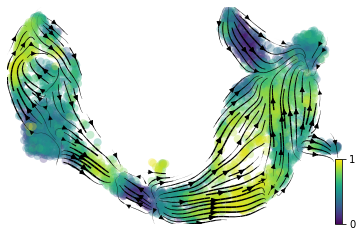

In [18]:
# Velocity embedding based on top 5 dynamic genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(dyn5Genes))) 
adata.uns['velocity_graph_top5_dynGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top5_dynGenes'])

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


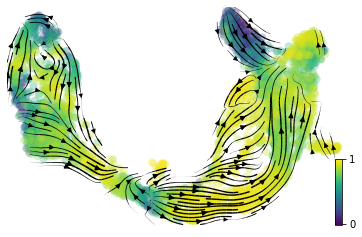

In [19]:
# Velocity embedding based on top 10 dynamic genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(dyn10Genes))) 
adata.uns['velocity_graph_top10_dynGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top10_dynGenes'])

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


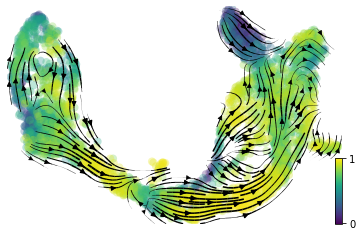

In [20]:
# Velocity embedding based on top 30 dynamic genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(dyn30Genes))) 
adata.uns['velocity_graph_top30_dynGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top30_dynGenes'])

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


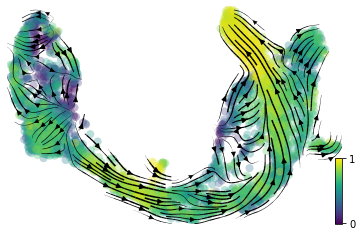

In [21]:
# Velocity embedding based on top 5 velocity genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(velo5Genes))) 
adata.uns['velocity_graph_top5_veloGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top5_veloGenes'])

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


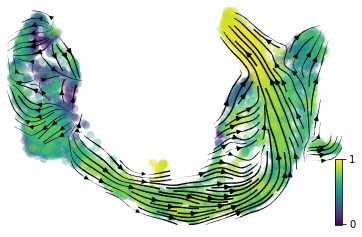

In [22]:
# Velocity embedding based on top 10 velocity genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(velo10Genes))) 
adata.uns['velocity_graph_top10_veloGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top10_veloGenes'])

computing velocity graph (using 1/64 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


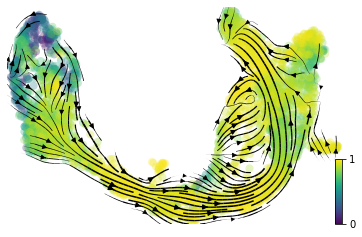

In [23]:
# Velocity embedding based on top 30 velocity genes per cluster

scv.tl.velocity_graph(adata, gene_subset=list(set(velo30Genes))) 
adata.uns['velocity_graph_top30_veloGenes'] = adata.uns['velocity_graph']
scv.pl.velocity_embedding_stream(adata, color=corr_df_dict['velocity_graph_top30_veloGenes'])

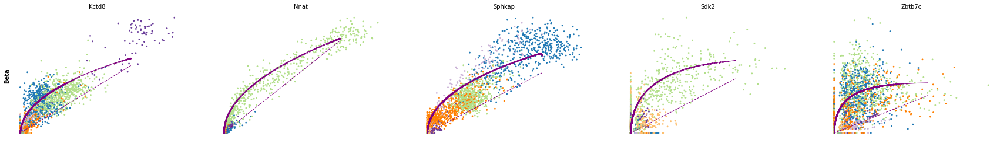

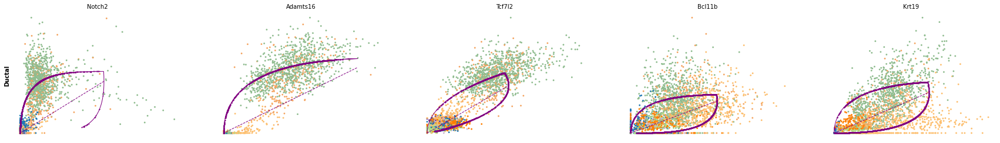

In [24]:
# Visualize top velocity markers in Beta and Ductal cells

for cluster in ['Beta', 'Ductal']:
    scv.pl.scatter(adata, df2[cluster][:5], ylabel=cluster, frameon=False)

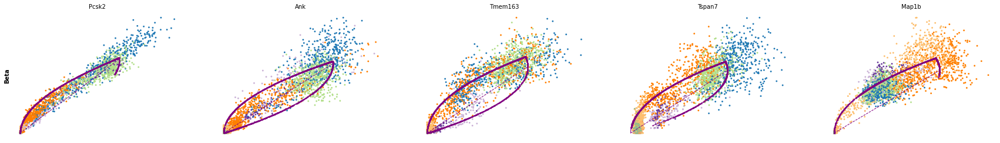

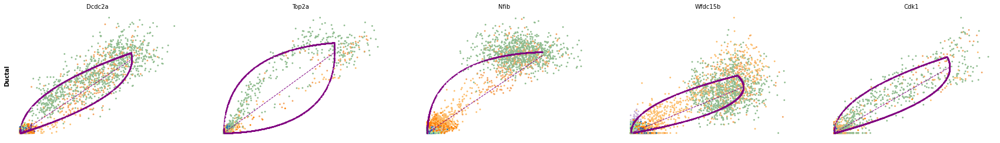

In [25]:
# Visualize top dynamic markers in Beta and Ductal cells

for cluster in ['Beta', 'Ductal']:
    scv.pl.scatter(adata, df[cluster][:5], ylabel=cluster, frameon=False)